# HOMEWORK 3

## Unsharp Masking Overview

Unsharp Masking (USM) is a classical image processing technique used to enhance the sharpness of an image by amplifying its high-frequency components. The method works by subtracting a blurred (unsharp) version of the image from the original and then adding the result back to the original image, weighted by a scaling factor.

The core formula is:

`sharpened = original + (original − unsharp) × amount`

This approach emphasizes edges and fine details, making the image appear sharper. In this work, the algorithm was applied to various versions of the same image using different blur intensities and `amount` values to evaluate its effectiveness under different conditions.

In [39]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

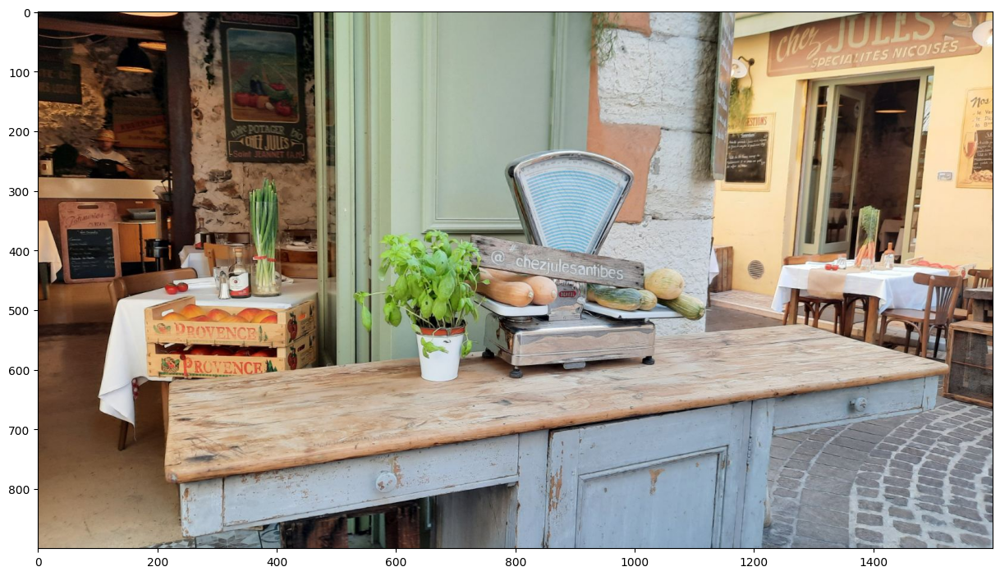

In [ ]:
original = cv2.imread('data/Antibes.jpg')
original = cv2.cvtColor(original)
plt.imshow(original)

## Experiment 1
### Mild Blur (5×5, σ=1.0)

In [ ]:
unsharp1 = cv2.GaussianBlur(original, (5, 5), sigmaX=1.0)

In [ ]:
diff1 = original.astype(np.float32) - unsharp1.astype(np.float32)

In [132]:
def prepare_img(unsharp, diff, param = None):
    plt.figure(figsize=(16, 4))

    plt.subplot(1, 2, 1)
    plt.title(f"GaussianBlur {param}")
    plt.imshow(unsharp)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title("Difference Image (Original − Blurred)")
    plt.imshow(diff)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-81.0..95.0].


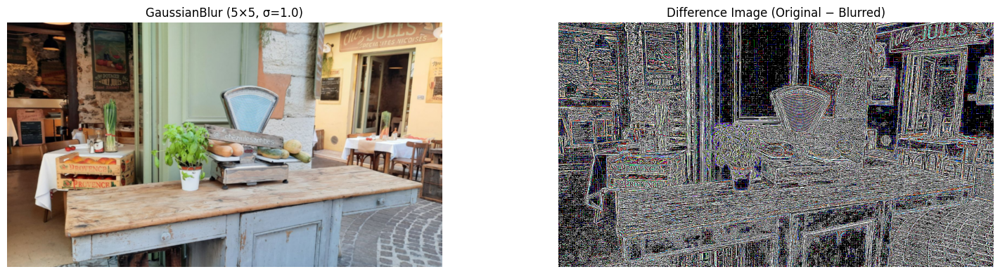

In [133]:
prepare_img(unsharp1, diff1, param = '(5×5, σ=1.0)')

In [ ]:
amount = 0.5
sharpened1_05 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp1.astype(np.float32))
sharpened1_05 = np.clip(sharpened1_05, 0, 255).astype(np.uint8)

amount = 1.5
sharpened1_15 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp1.astype(np.float32))
sharpened1_15 = np.clip(sharpened1_15, 0, 255).astype(np.uint8)

amount = 2.5
sharpened1_25 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp1.astype(np.float32))
sharpened1_25 = np.clip(sharpened1_25, 0, 255).astype(np.uint8)

In [120]:
def compare_img(original, sharpened_05, sharpened_15, sharpened_25, crop_coords):
    (y1, y2), (x1, x2) = crop_coords

    crop_orig = original[y1:y2, x1:x2]
    crop_05 = sharpened_05[y1:y2, x1:x2]
    crop_15 = sharpened_15[y1:y2, x1:x2]
    crop_25 = sharpened_25[y1:y2, x1:x2]

    plt.figure(figsize=(16, 4))

    plt.subplot(1, 4, 1)
    plt.title("Original")
    plt.imshow(crop_orig)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title("USM (amount = 0.5)")
    plt.imshow(crop_05)
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("USM (amount = 1.5)")
    plt.imshow(crop_15)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title("USM (amount = 2.5)")
    plt.imshow(crop_25)
    plt.axis('off')

    plt.tight_layout()
    plt.show()


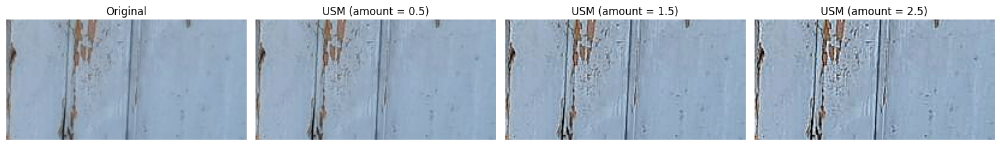

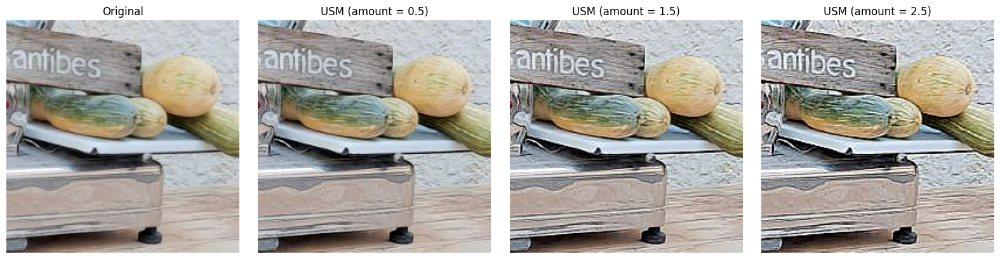

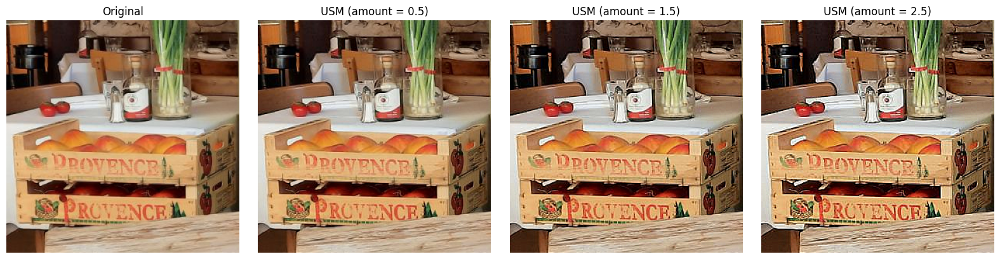

In [128]:
compare_img(original, sharpened1_05, sharpened1_15, sharpened1_25, ((800, 1000), (800, 1000)))
compare_img(original, sharpened1_05, sharpened1_15, sharpened1_25, ((400, 600), (900, 1100)))
compare_img(original, sharpened1_05, sharpened1_15, sharpened1_25, ((350, 650), (170, 470)))


## Experiment 2
### Moderate Blur (9×9, σ=2.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-128.0..135.0].


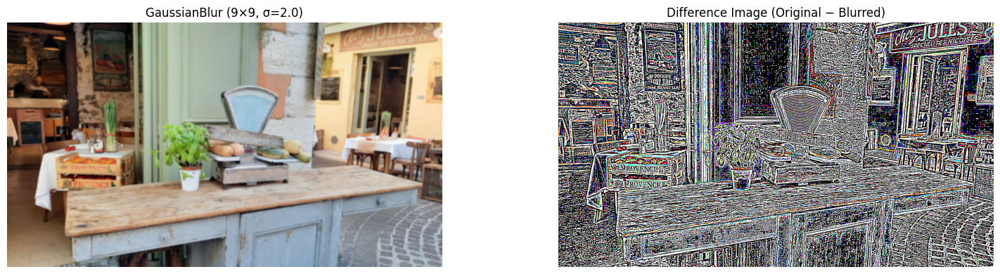

In [134]:
unsharp2 = cv2.GaussianBlur(original, (9, 9), sigmaX=2.0)
diff2 = original.astype(np.float32) - unsharp2.astype(np.float32)
prepare_img(unsharp2, diff2, param = '(9×9, σ=2.0)')

In [126]:
amount = 0.5
sharpened2_05 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp2.astype(np.float32))
sharpened2_05 = np.clip(sharpened2_05, 0, 255).astype(np.uint8)

amount = 1.5
sharpened2_15 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp2.astype(np.float32))
sharpened2_15 = np.clip(sharpened2_15, 0, 255).astype(np.uint8)

amount = 2.5
sharpened2_25 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp2.astype(np.float32))
sharpened2_25 = np.clip(sharpened2_25, 0, 255).astype(np.uint8)

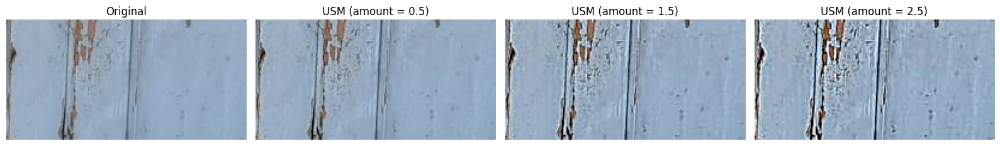

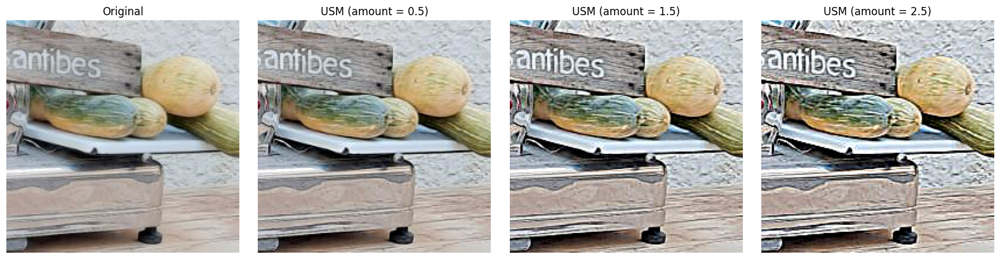

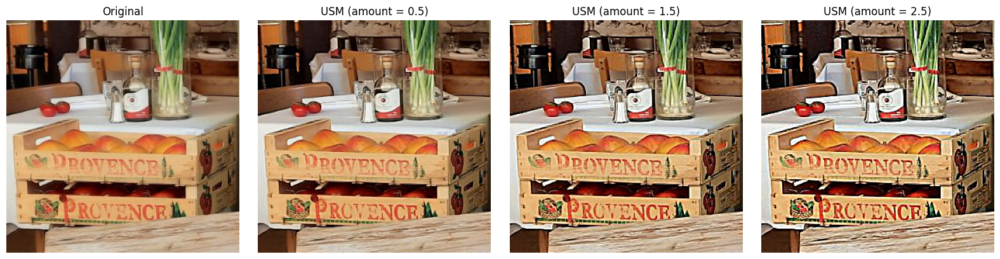

In [127]:
compare_img(original, sharpened2_05, sharpened2_15, sharpened2_25, ((800, 1000), (800, 1000)))
compare_img(original, sharpened2_05, sharpened2_15, sharpened2_25, ((400, 600), (900, 1100)))
compare_img(original, sharpened2_05, sharpened2_15, sharpened2_25, ((350, 650), (170, 470)))

## Experiment 3
### Strong Blur (15×15, σ=4.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-160.0..160.0].


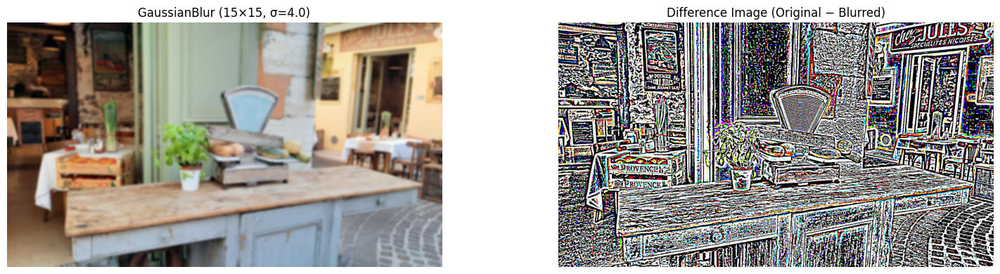

In [135]:
unsharp3 = cv2.GaussianBlur(original, (15, 15), sigmaX=4.0)
diff3 = original.astype(np.float32) - unsharp3.astype(np.float32)
prepare_img(unsharp3, diff3, param = '(15×15, σ=4.0)')

In [138]:
amount = 0.5
sharpened3_05 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp3.astype(np.float32))
sharpened3_05 = np.clip(sharpened3_05, 0, 255).astype(np.uint8)

amount = 1.5
sharpened3_15 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp3.astype(np.float32))
sharpened3_15 = np.clip(sharpened3_15, 0, 255).astype(np.uint8)

amount = 2.5
sharpened3_25 = original.astype(np.float32) + amount * (original.astype(np.float32) - unsharp3.astype(np.float32))
sharpened3_25 = np.clip(sharpened3_25, 0, 255).astype(np.uint8)

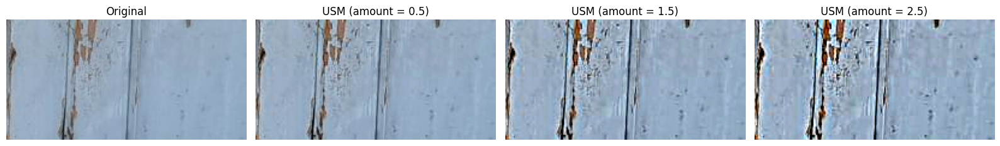

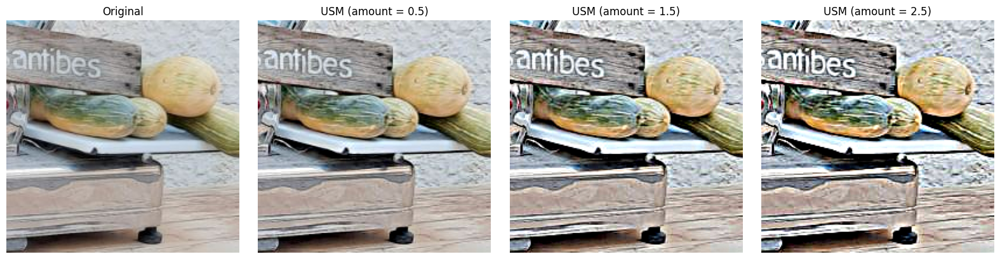

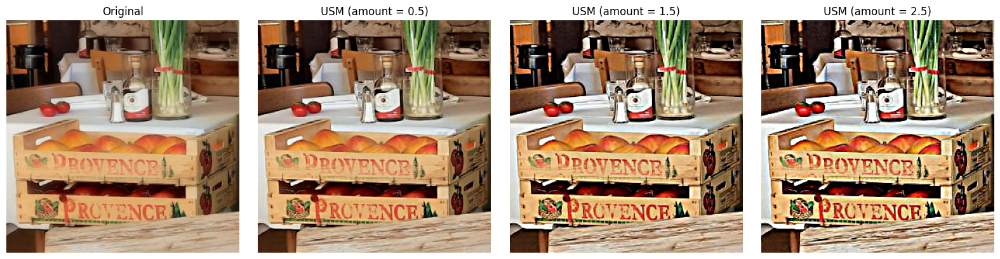

In [139]:
compare_img(original, sharpened3_05, sharpened3_15, sharpened3_25, ((800, 1000), (800, 1000)))
compare_img(original, sharpened3_05, sharpened3_15, sharpened3_25, ((400, 600), (900, 1100)))
compare_img(original, sharpened3_05, sharpened3_15, sharpened3_25, ((350, 650), (170, 470)))

## Experiment 4
### Noisy Image Test

Gaussian noise was deliberately added to the original image in order to evaluate the limitations of Unsharp Masking when applied to degraded or noisy data.

The noise was generated using a normal distribution with zero mean and a standard deviation σ = 20:

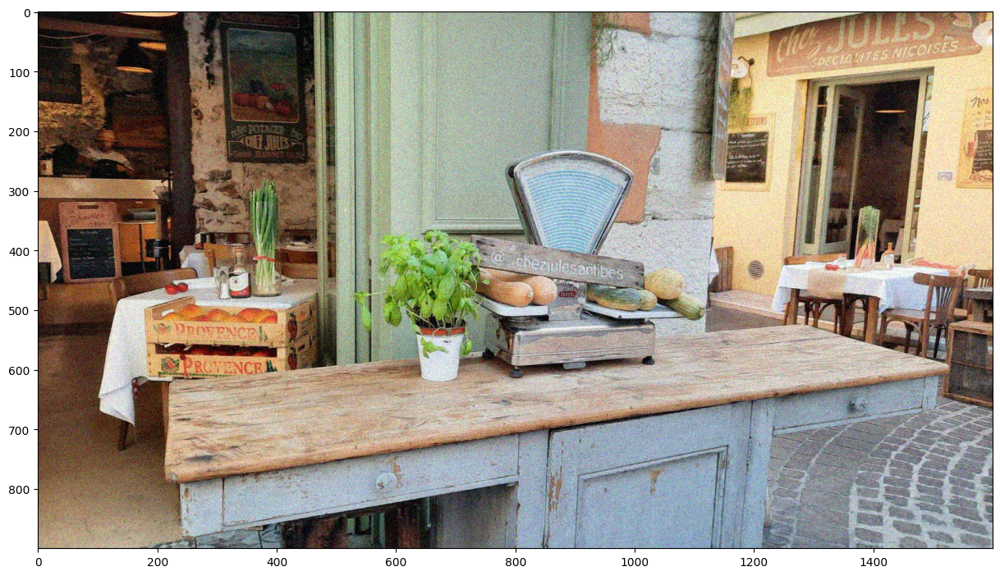

In [ ]:
def add_gaussian_noise(image, mean=0, sigma=20):
    noise = np.random.normal(mean, sigma, image.shape).astype(np.float32)
    noisy = image.astype(np.float32) + noise
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy

original_noisy = add_gaussian_noise(original)
plt.imshow(original_noisy)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-151.0..168.0].


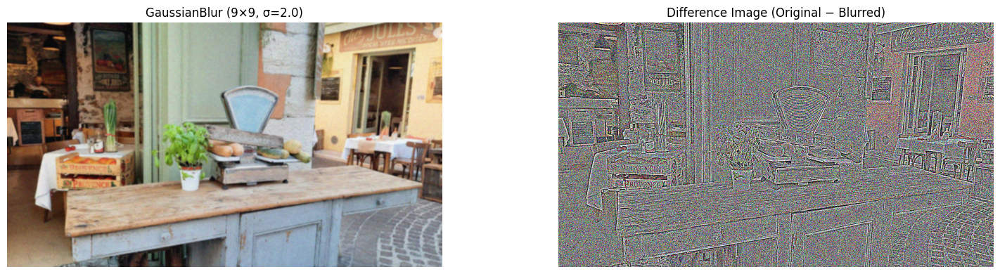

In [152]:
unsharp4 = cv2.GaussianBlur(original_noisy, (9, 9), sigmaX=2.0)
diff4 = original_noisy.astype(np.float32) - unsharp4.astype(np.float32)
prepare_img(unsharp4, diff4, param = '(9×9, σ=2.0)')

In [153]:
amount = 0.5
sharpened4_05 = original_noisy.astype(np.float32) + amount * (original_noisy.astype(np.float32) - unsharp4.astype(np.float32))
sharpened4_05 = np.clip(sharpened4_05, 0, 255).astype(np.uint8)

amount = 1.5
sharpened4_15 = original_noisy.astype(np.float32) + amount * (original_noisy.astype(np.float32) - unsharp4.astype(np.float32))
sharpened4_15 = np.clip(sharpened4_15, 0, 255).astype(np.uint8)

amount = 2.5
sharpened4_25 = original_noisy.astype(np.float32) + amount * (original_noisy.astype(np.float32) - unsharp4.astype(np.float32))
sharpened4_25 = np.clip(sharpened4_25, 0, 255).astype(np.uint8)

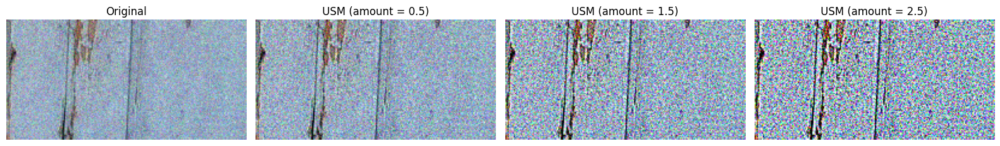

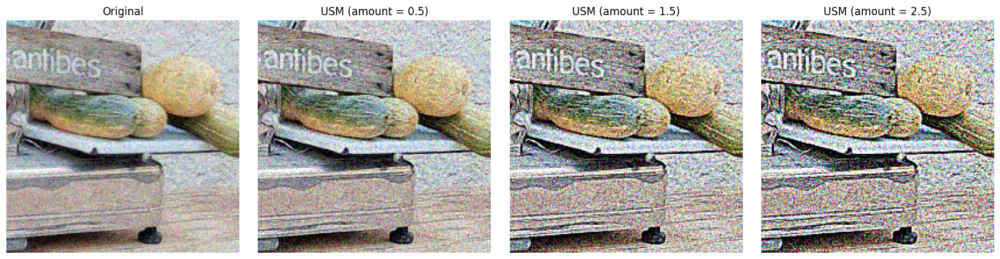

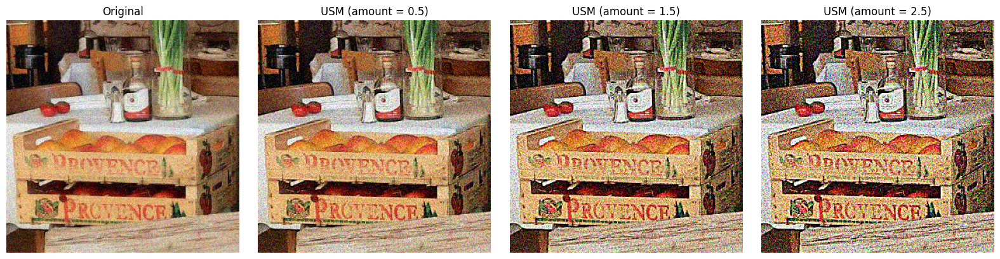

In [154]:
compare_img(original_noisy, sharpened4_05, sharpened4_15, sharpened4_25, ((800, 1000), (800, 1000)))
compare_img(original_noisy, sharpened4_05, sharpened4_15, sharpened4_25, ((400, 600), (900, 1100)))
compare_img(original_noisy, sharpened4_05, sharpened4_15, sharpened4_25, ((350, 650), (170, 470)))

### Questions
* What is a good (reasonable) value for the `amount` parameter?
 * What happens if it is too small?
 * What happens if it is too large?

## Unsharp Masking Experiment

The Unsharp Masking (USM) algorithm was applied to the same image using different combinations of Gaussian blur parameters and sharpening strength in order to analyze the influence of the `amount` parameter.

Three levels of Gaussian blur were tested prior to sharpening:
- **Mild Blur** with a small kernel and low sigma (5×5, σ=1.0),
- **Moderate Blur** with balanced parameters (9×9, σ=2.0),
- **Strong Blur** with aggressive settings (15×15, σ=4.0).

For each blur level, Unsharp Masking was applied using three different values of the `amount` parameter: **0.5**, **1.5**, and **2.5**.  
This setup enabled the analysis of how sharpening strength interacts with the degree of blur.

### Results and Discussion

When `amount = 0.5`, the sharpening effect was very subtle and often barely noticeable, especially in the case of mild blur.  
This value is suitable only for very gentle enhancement.

When `amount = 1.5`, the sharpening effect became clearly visible while preserving a natural appearance of the image.  
In particular, the combination of **moderate blur (9×9, σ=2.0)** and **`amount = 1.5`** produced the best visual result: edges were sharper, fine details were enhanced, and no strong artifacts were introduced.

When `amount = 2.5`, the sharpening became too aggressive.  
With strong blur, this resulted in visible halo artifacts around edges and an unnatural, over-sharpened look.

Additionally, the behavior of the algorithm was tested on a degraded version of the image by adding Gaussian noise (σ = 20). The purpose was to observe whether USM could improve sharpness without amplifying noise.

However, it was observed that USM enhanced not only the useful edges but also the noise patterns, making the image appear even more degraded. 
This happens because the sharpening formula:

$$
\text{sharpened} = \text{original} + \text{amount} \times (\text{original} - \text{blurred})
$$

boosts all high-frequency components — and **noise is also high-frequency**. Since the algorithm cannot distinguish between meaningful details and random noise, both are enhanced equally.

### Conclusion

A reasonable value for the `amount` parameter lies in the range **1.0–2.0**.  
If the value is too small, the sharpening effect is negligible; if it is too large, noise and halo artifacts dominate the image.  
Based on the experiments, the best balance between sharpness and visual quality was achieved using **moderate Gaussian blur combined with a medium `amount` value (1.5)**.

These observations confirm that Unsharp Masking should be used with caution on noisy images, as it tends to amplify noise along with real details. For optimal results, **denoising should be applied first** before using USM.